# Skin Lesion Classification using HAM10000 Dataset
By: Javier H
Colab link: https://colab.research.google.com/drive/1nRPYG89MtCRq3KMUJHQtVbq7sAagepEv?usp=sharing

This project explores the use of deep learning to classify skin lesion images into seven diagnostic categories using the **HAM10000 (Human Against Machine with 10000 training images)** dataset. Skin cancer is one of the most common types of cancer globally, and early detection plays a vital role in improving patient outcomes. Automating diagnosis using machine learning can help dermatologists with faster and more consistent screening.

## Dataset Overview

The dataset used is the **HAM10000** dataset, publicly available on [Kaggle](https://www.kaggle.com/datasets/kmader/skin-cancer-mnist-ham10000). It contains **10,015 dermatoscopic images** of pigmented lesions, curated from multiple sources for the purpose of machine learning research.

### Classes (Skin Lesion Types):

| Label | Abbreviation | Meaning                                                                                       |
|-------|--------------|-----------------------------------------------------------------------------------------------|
| 0     | akiec        | Actinic keratoses and intraepithelial carcinoma/Bowen disease                                 |
| 1     | bcc          | Basal cell carcinoma                                                                          |
| 2     | bkl          | Benign lesions of the keratosis type (solar lentigine/seborrheic keratoses and lichen-planus like keratosis) |
| 3     | df           | Dermatofibroma                                                                               |
| 4     | mel          | Melanoma                                                                                    |
| 5     | nv           | Melanocytic nevi                                                                            |
| 6     | vasc         | Vascular lesions (angiomas, angiokeratomas, pyogenic granulomas and hemorrhages)             |

**Note:** The dataset is highly imbalanced, with 'nv' making up the majority of images. This imbalance will become a significant problem evident during model evaluation.

---

## Objective

To train a convolutional neural network (CNN) that can accurately classify dermatoscopic images into one of the seven skin lesion categories. Evaluation metrics include accuracy, loss, and confusion matrix analysis on a stratified test set.

---

## Why This Matters

Skin cancer detection is a domain where machine learning can provide real-world impact. Manual diagnosis by dermatologists is subject to visual fatigue and variation in interpretation. A robust, automated model can assist in triaging patients and identifying high-risk lesions early.

---

## Techniques Used

- **Transfer Learning** with pre-trained CNN backbones (e.g., EfficientNet, ResNet)  
- **Data Augmentation** to address class imbalance and overfitting  
- **Class-wise evaluation** using confusion matrices  
- **Validation and test split** to assess generalization  
- **Categorical cross-entropy loss** for multi-class classification  

---

## Dataset Splits

The dataset was split as follows:

- **Training Set**: ~70%  
- **Validation Set**: ~15%  
- **Test Set**: ~15%  

Splits were stratified to preserve class distribution across all subsets.

---

## Challenges

- Severe class imbalance (e.g., over 4600 images for `nv`, but fewer than 100 for `df`, `vasc`)  
- High visual similarity between certain lesion types (e.g., `bkl` vs `nv`)  
- Risk of overfitting on the dominant class  
- Limited test performance despite high training accuracy — highlighting the importance of robust evaluation  

---

## Outcomes

Despite good training performance, the model demonstrates reduced generalization on the test set, suggesting further work is needed in:

- Handling class imbalance (e.g., weighted loss, oversampling)  
- Improving augmentation strategies
- Fine-tuning on the MobileNetV2 backbone

Confusion matrix analysis was crucial for understanding which classes were most often misclassified and why.

---

## Credits

Dataset: [HAM10000 - Kaggle](https://www.kaggle.com/datasets/kmader/skin-cancer-mnist-ham10000)  
Original Challenge: [ISIC 2018 Challenge](https://challenge2018.isic-archive.com)  
Harvard Dataverse: [HAM10000 Dataset](https://dataverse.harvard.edu/dataset.xhtml?persistentId=doi:10.7910/DVN/DBW86T)  

Key references:  
1. Noel Codella, Veronica Rotemberg, Philipp Tschandl, M. Emre Celebi, Stephen Dusza, David Gutman, Brian Helba, Aadi Kalloo, Konstantinos Liopyris, Michael Marchetti, Harald Kittler, Allan Halpern:  
“Skin Lesion Analysis Toward Melanoma Detection 2018: A Challenge Hosted by the International Skin Imaging Collaboration (ISIC)”, 2018; [https://arxiv.org/abs/1902.03368](https://arxiv.org/abs/1902.03368)  

2. Tschandl, P., Rosendahl, C. & Kittler, H.  
The HAM10000 dataset, a large collection of multi-source dermatoscopic images of common pigmented skin lesions. Sci. Data 5, 180161 doi:10.1038/sdata.2018.161 (2018).

## Importing Dataset

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Upload Kaggle API key
from google.colab import files
files.upload()

In [ ]:
import os
import zipfile

# Move the kaggle.json file to the correct location
os.makedirs("/root/.kaggle", exist_ok=True)
os.rename("kaggle.json", "/root/.kaggle/kaggle.json")

# Set permissions
os.chmod("/root/.kaggle/kaggle.json", 600)

## Setting up the dataset

In [ ]:
!kaggle datasets download -d kmader/skin-cancer-mnist-ham10000

Dataset URL: https://www.kaggle.com/datasets/kmader/skin-cancer-mnist-ham10000
License(s): CC-BY-NC-SA-4.0
 99% 5.15G/5.20G [02:18<00:03, 15.9MB/s]
100% 5.20G/5.20G [02:18<00:00, 40.3MB/s]


In [ ]:
import zipfile
import os

with zipfile.ZipFile("skin-cancer-mnist-ham10000.zip", 'r') as zip_ref:
    zip_ref.extractall("HAM10000")

## Merging images

In [ ]:
import torch
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Using device:", device)

Using device: cuda


In [ ]:
import os
import shutil

# Create a working folder for all images
all_images_dir = "/content/HAM10000/all_images"
os.makedirs(all_images_dir, exist_ok=True)

# Merge lowercased image folders (these contain actual images)
for folder in ["ham10000_images_part_1", "ham10000_images_part_2"]:
    folder_path = os.path.join("/content/HAM10000", folder)
    for filename in os.listdir(folder_path):
        if filename.lower().endswith((".jpg", ".jpeg", ".png")):
            src = os.path.join(folder_path, filename)
            dst = os.path.join(all_images_dir, filename)
            shutil.copyfile(src, dst)

## Organizing Data

### Significance of Metadata Fields for Classification

| Field         | Description                                                                 | Use in Classification | Explanation                                                                 |
|---------------|-----------------------------------------------------------------------------|------------------------|-----------------------------------------------------------------------------|
| `lesion_id`   | Identifier for a specific lesion; multiple images may share the same lesion | No                  | Useful for grouping related images, but not predictive of diagnosis.        |
| `image_id`    | Unique identifier for the image file (e.g., ISIC_0028498)                   | No                  | Used to load the correct image; contains no class or diagnostic information.|
| `dx`          | Diagnosis label for the lesion (e.g., melanoma, nv, bkl)                    | Yes                 | This is the ground truth label used for training the classifier.            |
| `dx_type`     | Method used to obtain the diagnosis (e.g., histopathology, consensus)       | No                  | Indicates label reliability but not a class to predict.                     |
| `age`         | Age of the patient in years                                                 | No                  | May be correlated with diagnosis but is not the target class.               |
| `sex`         | Biological sex of the patient (male or female)                              | No                  | May influence prevalence, but we are not predicting patient sex.            |
| `localization`| Body site of the lesion (e.g., back, face, arm)                             | No                  | Provides context but not the diagnosis; not used as the prediction target.  |

We use `dx` for classification because it contains the **diagnostic category** we want the CNN to learn. Other fields are informative or descriptive, but not directly suitable as classification targets.

In [ ]:
# Load metadata
import pandas as pd

metadata = pd.read_csv("/content/HAM10000/HAM10000_metadata.csv")

# Map label (dx) to full image filename
metadata['image_file'] = metadata['image_id'] + ".jpg"

# Target base path
sorted_base = "/content/HAM10000/sorted"
os.makedirs(sorted_base, exist_ok=True)

# Create class folders and copy images
for _, row in metadata.iterrows():
    label = row['dx']  # e.g. 'melanoma', 'nv'
    src = os.path.join(all_images_dir, row['image_file'])
    dst_dir = os.path.join(sorted_base, label)
    dst = os.path.join(dst_dir, row['image_file'])

    os.makedirs(dst_dir, exist_ok=True)

    # Copy image into class folder if it exists
    if os.path.exists(src):
        shutil.copyfile(src, dst)

In [ ]:
import os
import shutil
import pandas as pd

# Load metadata and attach image paths
metadata = pd.read_csv("/content/HAM10000/HAM10000_metadata.csv")
metadata['image_file'] = metadata['image_id'] + ".jpg"
metadata['image_path'] = "/content/HAM10000/all_images/" + metadata['image_file']

# Filter out missing files (if any)
metadata = metadata[metadata['image_path'].apply(os.path.exists)]

In [ ]:
from sklearn.model_selection import train_test_split

# Split into train, val, test (70/15/15), stratified by 'dx'
train_df, temp_df = train_test_split(metadata, test_size=0.3, stratify=metadata['dx'], random_state=42)
val_df, test_df = train_test_split(temp_df, test_size=0.5, stratify=temp_df['dx'], random_state=42)

In [ ]:
# Confirm class balance
print("Train class distribution:\n", train_df['dx'].value_counts())
print("Val class distribution:\n", val_df['dx'].value_counts())
print("Test class distribution:\n", test_df['dx'].value_counts())

Train class distribution:
 dx
nv       4693
mel       779
bkl       769
bcc       360
akiec     229
vasc       99
df         81
Name: count, dtype: int64
Val class distribution:
 dx
nv       1006
mel       167
bkl       165
bcc        77
akiec      49
vasc       21
df         17
Name: count, dtype: int64
Test class distribution:
 dx
nv       1006
mel       167
bkl       165
bcc        77
akiec      49
vasc       22
df         17
Name: count, dtype: int64


In [ ]:
# Helper function to copy images into class-labeled folders
def copy_images(df, split_name, base_dst="/content/HAM10000/split_data"):
    """
    Copies image files into a directory structure organized by split and class label.

    Parameters:
        df (DataFrame): Pandas DataFrame containing at least 'dx', 'image_path', and 'image_file' columns.
        split_name (str): Name of the data split (e.g., 'train', 'val', 'test') used as a subdirectory.
        base_dst (str): Base directory where split folders will be created.

    The resulting structure will be:
    base_dst/split_name/class_label/image_file.jpg
    """
    split_dir = os.path.join(base_dst, split_name)
    for _, row in df.iterrows():
        label = row['dx']
        src = row['image_path']
        dst_dir = os.path.join(split_dir, label)
        os.makedirs(dst_dir, exist_ok=True)
        dst = os.path.join(dst_dir, row['image_file'])
        shutil.copyfile(src, dst)

In [ ]:
# Copy images into split folders
copy_images(train_df, "train")
copy_images(val_df, "val")
copy_images(test_df, "test")

In [ ]:
def print_split_summary(df, name):
    """
    Prints a summary of the dataset split, including total image count and class distribution.

    Parameters:
        df (DataFrame): Pandas DataFrame containing a 'dx' column with class labels.
        name (str): Name of the split (e.g., 'Train', 'Validation', 'Test') for display purposes.
    """
    print(f"\n{name} Split Summary:")
    print(f"Total images: {len(df)}")
    print("Class distribution:")
    print(df['dx'].value_counts())

In [ ]:
# Print summary of each split
print_split_summary(train_df, "Train")
print_split_summary(val_df, "Validation")
print_split_summary(test_df, "Test")


Train Split Summary:
Total images: 7010
Class distribution:
dx
nv       4693
mel       779
bkl       769
bcc       360
akiec     229
vasc       99
df         81
Name: count, dtype: int64

Validation Split Summary:
Total images: 1502
Class distribution:
dx
nv       1006
mel       167
bkl       165
bcc        77
akiec      49
vasc       21
df         17
Name: count, dtype: int64

Test Split Summary:
Total images: 1503
Class distribution:
dx
nv       1006
mel       167
bkl       165
bcc        77
akiec      49
vasc       22
df         17
Name: count, dtype: int64


In [ ]:
import matplotlib.pyplot as plt
import os
from PIL import Image

def show_image_with_label(image_path):
    """
    Displays an image using matplotlib with its class label (parent folder name) as the title.

    Parameters:
        image_path (str): Path to the image file.
    """
    image = Image.open(image_path)
    label = os.path.basename(os.path.dirname(image_path))

    plt.imshow(image)
    plt.title(f"Class: {label}")
    plt.axis('off')
    plt.show()

In [ ]:
import random

def get_random_image_path(root_dir):
    """
    Selects a random image file from a directory or its subdirectories.

    Parameters:
        root_dir (str): Root directory to search for image files.

    Returns:
        str: Full path to a randomly selected image.
    """
    valid_exts = (".jpg", ".jpeg", ".png")
    image_paths = [
        os.path.join(dp, f)
        for dp, _, filenames in os.walk(root_dir)
        for f in filenames if f.lower().endswith(valid_exts)
    ]

    if not image_paths:
        raise ValueError(f"No image files found in {root_dir}")

    return random.choice(image_paths)

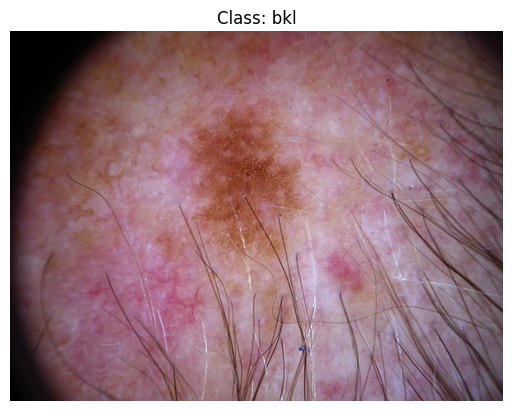

In [ ]:
train_dir = "/content/HAM10000/split_data/train"

# Visualize random image
random_train_image = get_random_image_path(train_dir)
show_image_with_label(random_train_image)

In [ ]:
import matplotlib.pyplot as plt
import random
import os
from PIL import Image

def display_image_grid(image_dir, grid_size=5, image_size=(128, 128)):
    """
    Display a grid of random images from a directory.

    Args:
        image_dir (str): Path to the directory containing class subfolders with images.
        grid_size (int): Number of images per row and column (default: 5 for 5x5 grid).
        image_size (tuple): Size to resize images for display (default: 128x128).
    """
    all_images = []
    # Traverse subfolders to collect image paths
    for root, _, files in os.walk(image_dir):
        for file in files:
            if file.lower().endswith(('.jpg', '.jpeg', '.png')):
                all_images.append(os.path.join(root, file))

    if len(all_images) < grid_size**2:
        print(f"Not enough images to display {grid_size**2}. Found only {len(all_images)}.")
        return

    sampled_images = random.sample(all_images, grid_size**2)

    # Plot the grid
    fig, axes = plt.subplots(grid_size, grid_size, figsize=(grid_size*2, grid_size*2))
    for ax, img_path in zip(axes.flatten(), sampled_images):
        img = Image.open(img_path).resize(image_size)
        ax.imshow(img)
        ax.axis('off')
        ax.set_title(os.path.basename(os.path.dirname(img_path)), fontsize=8)  # Show class name
    plt.tight_layout()
    plt.show()

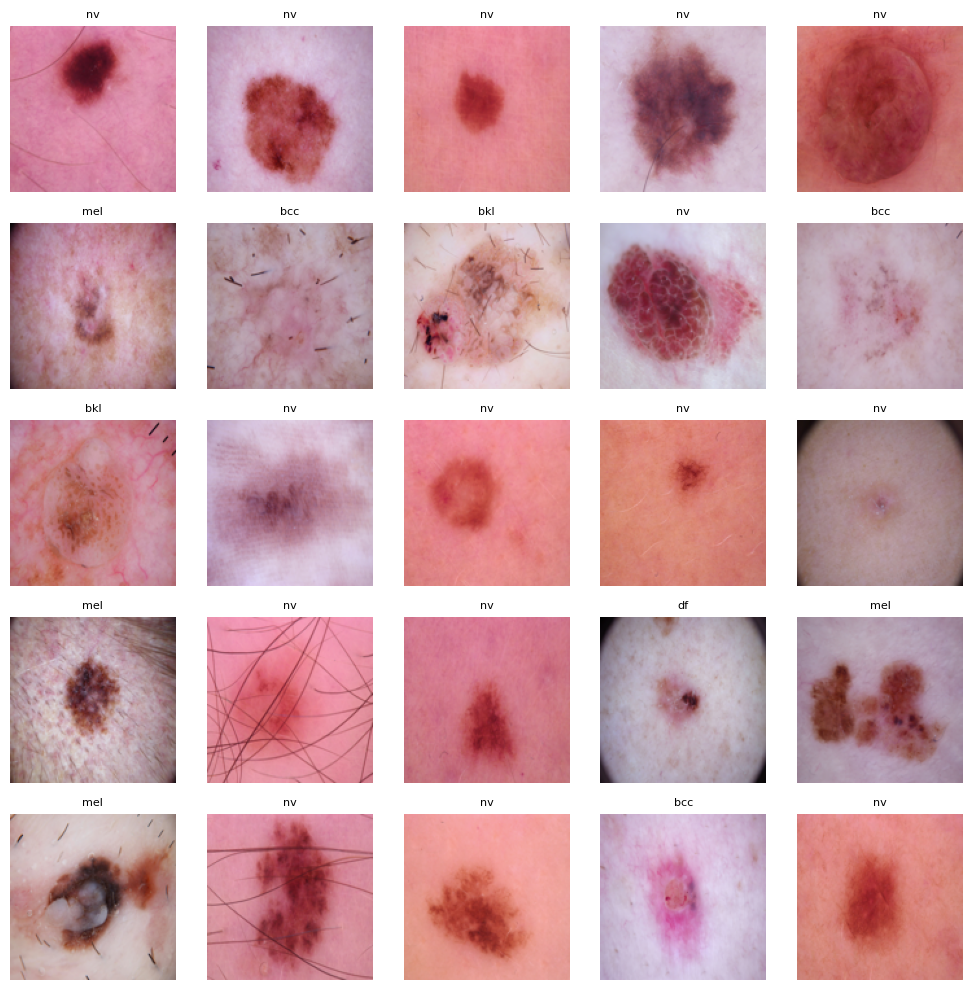

In [ ]:
display_image_grid(train_dir)

In [ ]:
BATCH_SIZE = 32 #@param {type:"slider",min:8,max:128,step:8}

In [ ]:
import tensorflow as tf

# Load dataset (no shuffling or batching yet)
train_ds = tf.keras.preprocessing.image_dataset_from_directory(
    train_dir,
    image_size=(224, 224),
    batch_size=BATCH_SIZE,
    label_mode="categorical"
)

# Define augmentation layer
data_augmentation = tf.keras.Sequential([
    tf.keras.layers.RandomFlip("horizontal"),
    tf.keras.layers.RandomRotation(0.1),
    tf.keras.layers.RandomZoom(0.1),
])

# Define MobileNet preprocessing
preprocess_input = tf.keras.applications.mobilenet_v2.preprocess_input

# Combine into full preprocessing pipeline
def preprocess_and_augment(image, label):
    image = data_augmentation(image)
    image = preprocess_input(image)
    return image, label

train_ds = train_ds.map(preprocess_and_augment)

Found 7010 files belonging to 7 classes.


We need to do this again for the other splits, so we should modularize into a function.

In [ ]:
def preprocess_dataset(dataset, augment=False):
    """
    Applies preprocessing (and optional augmentation) to a tf.data.Dataset.

    Parameters:
        dataset (tf.data.Dataset): Input dataset of (image, label) pairs.
        augment (bool): Whether to apply data augmentation.

    Returns:
        tf.data.Dataset: Transformed dataset with preprocessing (and augmentation if enabled).
    """
    if augment:
        def augment_fn(image, label):
            image = data_augmentation(image)
            image = preprocess_input(image)
            return image, label
        return dataset.map(augment_fn).cache().prefetch(tf.data.AUTOTUNE)
    else:
        def preprocess_fn(image, label):
            image = preprocess_input(image)
            return image, label
        return dataset.map(preprocess_fn).cache().prefetch(tf.data.AUTOTUNE)

In [ ]:
def load_dataset_from_directory(data_dir, batch_size=BATCH_SIZE, image_size=(224, 224), shuffle=True):
    """
    Loads images from directory structured as data_dir/class_label/image.jpg.

    Args:
        data_dir (str): Directory path to load data from.
        batch_size (int): Number of samples per batch.
        image_size (tuple): Image resize size (height, width).
        shuffle (bool): Whether to shuffle the data.

    Returns:
        tf.data.Dataset object with (image, label) pairs.
    """
    return tf.keras.utils.image_dataset_from_directory(
        data_dir,
        labels='inferred',
        label_mode='categorical',
        batch_size=batch_size,
        image_size=image_size,
        shuffle=shuffle
    )

In [ ]:
train_dir = "/content/HAM10000/split_data/train"
val_dir = "/content/HAM10000/split_data/val"
test_dir = "/content/HAM10000/split_data/test"

train_ds_pre = load_dataset_from_directory(train_dir, shuffle=True)
val_ds_pre = load_dataset_from_directory(val_dir, shuffle=False)
test_ds_pre = load_dataset_from_directory(test_dir, shuffle=False)

# Apply preprocessing
train_ds = preprocess_dataset(train_ds_pre, augment=True)
val_ds = preprocess_dataset(val_ds_pre, augment=False)
test_ds = preprocess_dataset(test_ds_pre, augment=False)

Found 7010 files belonging to 7 classes.
Found 1502 files belonging to 7 classes.
Found 1503 files belonging to 7 classes.


## Model Architecture Overview

This model uses **MobileNetV2** as a feature extractor, followed by a custom classification head for multi-class skin lesion classification. Here's a breakdown of the layers:

| Layer                         | Description                                                                 |
|------------------------------|-----------------------------------------------------------------------------|
| `InputLayer (224x224x3)`     | Accepts 224×224 RGB images as input, which is the expected size for MobileNetV2. |
| `MobileNetV2 (frozen)`       | Pretrained on ImageNet. Outputs deep feature maps (no top classification layer). |
| `GlobalAveragePooling2D`     | Converts the 3D feature maps into a 1D vector by averaging across spatial dimensions. |
| `Dropout(0.2)`               | Randomly drops 20% of the units during training to reduce overfitting.     |
| `Dense(128, relu)`           | Learns non-linear combinations of features before final classification.   |
| `Dense(num_classes, softmax)`| Outputs probabilities across diagnosis classes (e.g., nv, bkl, mel, etc.). |

This architecture allows the model to leverage powerful pretrained features while remaining lightweight and generalizable for the skin lesion task.

In [ ]:
# Load MobileNetV2 base
base_model = tf.keras.applications.MobileNetV2(
    input_shape=(224, 224, 3),
    include_top=False,
    weights='imagenet'
)
base_model.trainable = False

# Add classification head with intermediate Dense layer
model = tf.keras.Sequential([
    tf.keras.layers.InputLayer(input_shape=(224, 224, 3)),
    base_model,
    tf.keras.layers.GlobalAveragePooling2D(),
    tf.keras.layers.Dropout(0.2),
    tf.keras.layers.Dense(128, activation='relu'),  # Intermediate dense layer
    tf.keras.layers.Dense(train_ds.element_spec[1].shape[-1], activation='softmax')  # Final classifier
])

9406464/9406464 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(


In [ ]:
model.compile(
    optimizer=tf.keras.optimizers.Adam(),
    loss=tf.keras.losses.CategoricalCrossentropy(),
    metrics=['accuracy']
)

In [ ]:
model.summary()

Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ mobilenetv2_1.00_224            │ (None, 7, 7, 1280)     │     2,257,984 │
│ (Functional)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d        │ (None, 1280)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 1280)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 128)            │       163,968 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 7)              │           903 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,422,855 (9.24 MB)

 Trainable params: 164,871 (644.03 KB)

 Non-trainable params: 2,257,984 (8.61 MB)

In [ ]:
import datetime
import os
import tensorflow as tf

def create_tensorboard_callback(base_dir='/content/HAM10000/logs'):
    """
    Creates a TensorBoard callback with a timestamped log directory inside the given base directory.

    Args:
        base_dir (str): The base directory where logs should be stored.

    Returns:
        tf.keras.callbacks.TensorBoard: A configured TensorBoard callback instance.
    """
    timestamp = datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
    logdir = os.path.join(base_dir, "logs", timestamp)
    return tf.keras.callbacks.TensorBoard(log_dir=logdir)

In [ ]:
early_stopping = tf.keras.callbacks.EarlyStopping(monitor="val_accuracy",patience=3)

In [ ]:
NUM_EPOCHS = 20 #@param {type:"slider",min:1,max:100,step:1}

In [ ]:
history = model.fit(
    train_ds,
    validation_data=val_ds,
    epochs=NUM_EPOCHS,
    callbacks=[create_tensorboard_callback(),early_stopping]
)

Epoch 1/20
220/220 ━━━━━━━━━━━━━━━━━━━━ 161s 662ms/step - accuracy: 0.6658 - loss: 1.0313 - val_accuracy: 0.7423 - val_loss: 0.7221
Epoch 2/20
220/220 ━━━━━━━━━━━━━━━━━━━━ 55s 39ms/step - accuracy: 0.7445 - loss: 0.7152 - val_accuracy: 0.7517 - val_loss: 0.6756
Epoch 3/20
220/220 ━━━━━━━━━━━━━━━━━━━━ 8s 38ms/step - accuracy: 0.7686 - loss: 0.6446 - val_accuracy: 0.7497 - val_loss: 0.6640
Epoch 4/20
220/220 ━━━━━━━━━━━━━━━━━━━━ 10s 38ms/step - accuracy: 0.7780 - loss: 0.6002 - val_accuracy: 0.7577 - val_loss: 0.6569
Epoch 5/20
220/220 ━━━━━━━━━━━━━━━━━━━━ 8s 38ms/step - accuracy: 0.7884 - loss: 0.5584 - val_accuracy: 0.7563 - val_loss: 0.6536
Epoch 6/20
220/220 ━━━━━━━━━━━━━━━━━━━━ 10s 38ms/step - accuracy: 0.8007 - loss: 0.5430 - val_accuracy: 0.7577 - val_loss: 0.6516
Epoch 7/20
220/220 ━━━━━━━━━━━━━━━━━━━━ 10s 38ms/step - accuracy: 0.8077 - loss: 0.4985 - val_accuracy: 0.7503 - val_loss: 0.6631


## Displaying Training Results

In [ ]:
%load_ext tensorboard
%tensorboard --logdir /content/HAM10000/logs

<IPython.core.display.Javascript object>

In [ ]:
import tensorflow as tf
import os

def save_model(model, model_path):
    """
    Save a trained Keras model to the specified path.

    Args:
        model (tf.keras.Model): The trained model to save.
        model_path (str): Directory path where the model should be saved.
    """
    os.makedirs(os.path.dirname(model_path), exist_ok=True)
    model.save(model_path)
    print(f"Model saved to: {model_path}")

In [ ]:
import tensorflow as tf

def load_model(model_path):
    """
    Load a previously saved Keras model from the specified path.

    Args:
        model_path (str): Path to the saved model directory.

    Returns:
        tf.keras.Model: The loaded Keras model.
    """
    model = tf.keras.models.load_model(model_path)
    print(f"Model loaded from: {model_path}")
    return model

In [ ]:
model.evaluate(train_ds)

220/220 ━━━━━━━━━━━━━━━━━━━━ 9s 43ms/step - accuracy: 0.8289 - loss: 0.4569


[0.44251149892807007, 0.8373751640319824]

In [ ]:
model.evaluate(val_ds)

47/47 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - accuracy: 0.5531 - loss: 1.1266


[0.6631312370300293, 0.7503328919410706]

In [ ]:
model.evaluate(test_ds)
save_model(model, "/content/drive/MyDrive/Storage Bucket/ML/HAM10000/model.keras")

47/47 ━━━━━━━━━━━━━━━━━━━━ 16s 344ms/step - accuracy: 0.5713 - loss: 1.1991
Model saved to: /content/drive/MyDrive/Storage Bucket/ML/HAM10000/model.keras


While the overall test accuracy was 57%, this metric is heavily influenced by the overrepresentation of the 'nv' class, which dominates the dataset. Accuracy dropped due to poor generalization on minority classes like 'df', 'vasc', and 'akiec', each of which had fewer than 50 - 100 examples in the training set.

This imbalance caused the model to favor the majority class and misclassify rare conditions.

In [ ]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt

def plot_top_predictions(image_path, model, class_names, top_k=10):
    """
    Plot the top K prediction confidences for a given image.

    Args:
        image_path (str): Path to the image file.
        model (tf.keras.Model): Trained classification model.
        class_names (list): List of class labels (e.g. from train_ds.class_names).
        top_k (int): Number of top predictions to show (default 10).
    """
    # Load and preprocess image
    img = tf.keras.utils.load_img(image_path, target_size=(224, 224))
    img_array = tf.keras.utils.img_to_array(img)
    img_array = tf.expand_dims(img_array, 0)  # Make batch of 1
    img_preprocessed = tf.keras.applications.mobilenet_v2.preprocess_input(img_array)

    # Predict
    predictions = model.predict(img_preprocessed)[0]  # shape: (num_classes,)
    top_indices = predictions.argsort()[-top_k:][::-1]
    top_probs = predictions[top_indices]
    top_labels = [class_names[i] for i in top_indices]

    # Plot
    plt.figure(figsize=(8, 6))
    plt.barh(top_labels[::-1], top_probs[::-1], color="skyblue")
    plt.xlabel("Confidence")
    plt.title("Top Prediction Probabilities")
    plt.grid(axis='x', linestyle='--', alpha=0.6)
    plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step


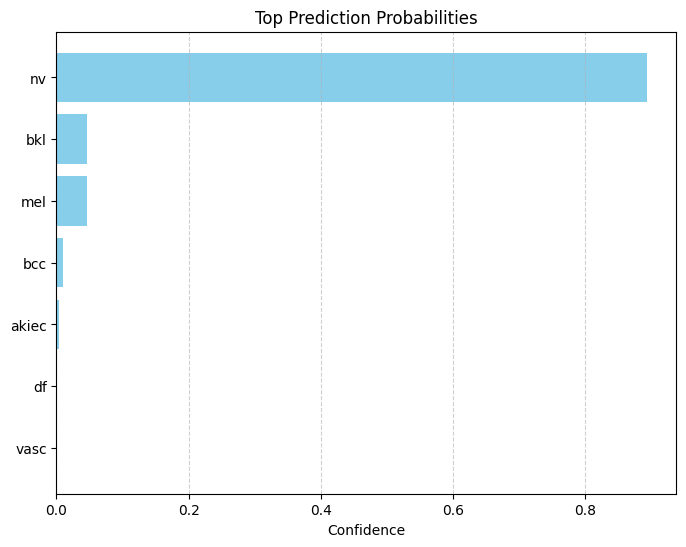

In [ ]:
image_path = get_random_image_path(val_dir)
plot_top_predictions(image_path, model, val_ds_pre.class_names)

In [ ]:
import tensorflow as tf
import matplotlib.pyplot as plt
import os
import numpy as np

def compare_prediction_with_truth(image_path, model, class_names):
    """
    Display the image along with predicted vs. true class comparison.

    Args:
        image_path (str): Full path to the image.
        model (tf.keras.Model): Trained classification model.
        class_names (List[str]): List of class names in label index order.
    """
    # Load and preprocess image
    image = tf.keras.preprocessing.image.load_img(image_path, target_size=(224, 224))
    image_array = tf.keras.preprocessing.image.img_to_array(image)
    image_array = tf.expand_dims(image_array, axis=0)  # Add batch dimension
    image_array = tf.keras.applications.mobilenet_v2.preprocess_input(image_array)

    # Predict
    predictions = model.predict(image_array)
    pred_idx = np.argmax(predictions[0])
    pred_label = class_names[pred_idx]
    pred_conf = predictions[0][pred_idx]

    # Extract true label from folder name
    true_label = os.path.basename(os.path.dirname(image_path))

    # Display
    plt.imshow(image)
    plt.axis("off")
    title_color = "green" if pred_label == true_label else "red"
    plt.title(
        f"Predicted: {pred_label} ({pred_conf*100:.1f}%)\nTrue: {true_label}",
        color=title_color,
        fontsize=12
    )
    plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step


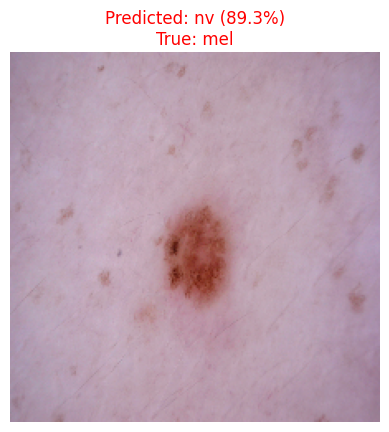

In [ ]:
compare_prediction_with_truth(image_path, model, val_ds_pre.class_names)

## Hyperparameter Tuning
We perform hyperparameter tuning in order to try to obtain a more accurate classification model.

This is done using the Keras Tuner library.

In [ ]:
!pip install keras_tuner

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 129.1/129.1 kB 2.6 MB/s eta 0:00:00


In [ ]:
import keras_tuner as kt
import gc
import tensorflow as tf

def build_model(hp):
    """
    Builds a Keras model for image classification with MobileNetV2 as the base.

    This function is intended for use with Keras Tuner. It clears the TensorFlow session
    and garbage collects unused memory before building a new model to reduce memory usage.

    Tunable hyperparameters:
    - dropout: Dropout rate after global average pooling.
    - units: Number of units in the dense layer.
    - lr: Learning rate for the Adam optimizer.

    Returns:
        A compiled tf.keras.Model instance.
    """

    # Free memory before building new model
    tf.keras.backend.clear_session()
    gc.collect()

    base_model = tf.keras.applications.MobileNetV2(
        input_shape=(224, 224, 3),
        include_top=False,
        weights='imagenet'
    )
    base_model.trainable = False

    model = tf.keras.Sequential([
        tf.keras.layers.InputLayer(input_shape=(224, 224, 3)),
        base_model,
        tf.keras.layers.GlobalAveragePooling2D(),
        tf.keras.layers.Dropout(hp.Choice("dropout", values=[0.2, 0.3])),
        tf.keras.layers.Dense(128, activation='relu'),
        tf.keras.layers.Dense(train_ds.element_spec[1].shape[-1], activation='softmax')
    ])

    model.compile(
        optimizer=tf.keras.optimizers.Adam(
            hp.Choice("lr", values=[1e-4, 3e-4])
        ),
        loss='categorical_crossentropy',
        metrics=['accuracy']
    )

    return model

Many iterations of the Hyperband results in RAM usage to the point at which Colab crashes. We thus reduce the iterations and executions

In [ ]:
tuner = kt.Hyperband(
    build_model,
    objective='val_accuracy',
    max_epochs=NUM_EPOCHS,
    factor=3,
    hyperband_iterations=1,
    executions_per_trial=1,
    directory='kt_tuner',
    project_name='mobilenetv2_tuning',
    overwrite=True
)

/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(


In [ ]:
tuner.search(
    train_ds,
    validation_data=val_ds,
    epochs=NUM_EPOCHS,
    callbacks=[create_tensorboard_callback('/content/HAM10000/logs/tuning'), early_stopping]
)

Trial 4 Complete [00h 01m 12s]
val_accuracy: 0.762316882610321

Best val_accuracy So Far: 0.762316882610321
Total elapsed time: 00h 04m 25s


In [ ]:
%load_ext tensorboard
%tensorboard --logdir /content/HAM10000/logs/tuning

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

In [ ]:
best_model = tuner.get_best_models(num_models=1)[0]

/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/keras/src/saving/saving_lib.py:802: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 10 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


In [ ]:
best_model.evaluate(train_ds)

220/220 ━━━━━━━━━━━━━━━━━━━━ 15s 44ms/step - accuracy: 0.7724 - loss: 0.6199


[0.6131548285484314, 0.7813124060630798]

In [ ]:
best_model.evaluate(val_ds)

47/47 ━━━━━━━━━━━━━━━━━━━━ 5s 100ms/step - accuracy: 0.5733 - loss: 1.1260


[0.679968535900116, 0.762316882610321]

In [ ]:
best_model.evaluate(test_ds)
save_model(model, "/content/drive/MyDrive/Storage Bucket/ML/HAM10000/best_model.keras")

47/47 ━━━━━━━━━━━━━━━━━━━━ 4s 80ms/step - accuracy: 0.5664 - loss: 1.1626
Model saved to: /content/drive/MyDrive/Storage Bucket/ML/HAM10000/best_model.keras


1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step


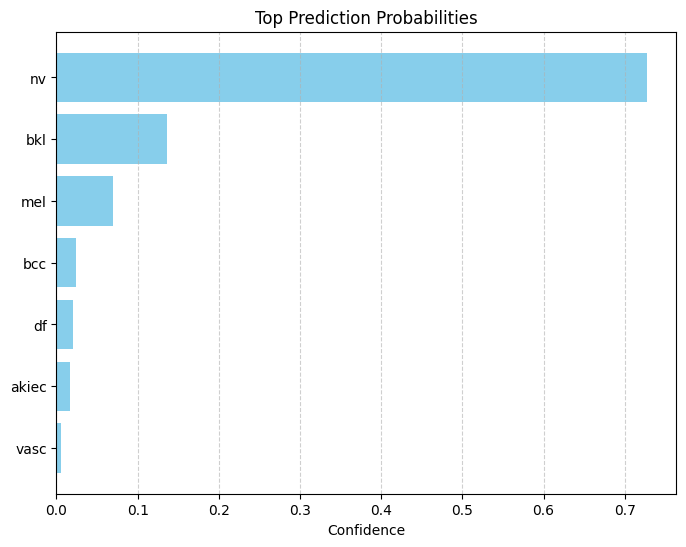

In [ ]:
image_path = get_random_image_path(val_dir)
plot_top_predictions(image_path, best_model, val_ds_pre.class_names)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step


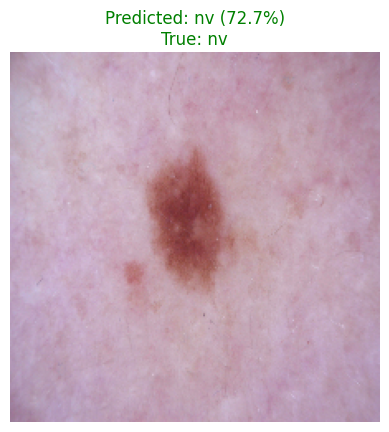

In [ ]:
compare_prediction_with_truth(image_path, best_model, val_ds_pre.class_names)

In [ ]:
## Plot confusion matrix

1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step
1/1 ━━━━━━

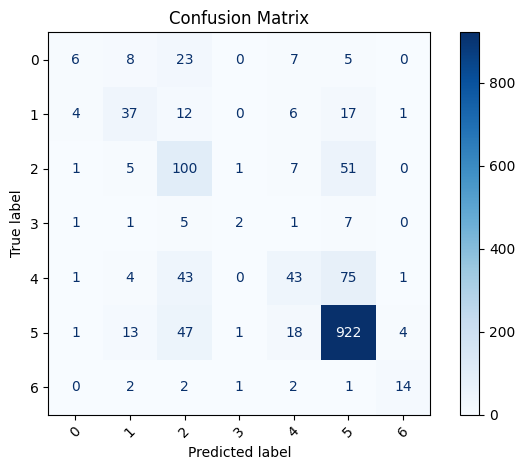

In [ ]:
import numpy as np
from sklearn.metrics import ConfusionMatrixDisplay
import matplotlib.pyplot as plt

y_true = []
y_pred = []

for images, labels in test_ds:
    preds = model.predict(images)
    y_true.extend(np.argmax(labels.numpy(), axis=1))
    y_pred.extend(np.argmax(preds, axis=1))

class_names = list(test_ds.class_names) if hasattr(test_ds, 'class_names') else None

disp = ConfusionMatrixDisplay.from_predictions(
    y_true, y_pred,
    display_labels=class_names,
    cmap=plt.cm.Blues,
    xticks_rotation=45
)

plt.title("Confusion Matrix")
plt.tight_layout()
plt.show()

## Confusion Matrix Results & Conclusion

Despite achieving a validation accuracy during training of 75%, our model’s performance on the test set revealed significant limitations as stated earlier, with an overall accuracy of approximately 55%. The confusion matrix further highlights a clear imbalance in predictive performance, with the model disproportionately favoring the dominant class (nv).

## Future Work

Future work will focus on addressing this imbalance through class weighting, data augmentation targeting rare classes, and fine-tuning of the pretrained MobileNetV2 backbone.
